In [15]:
#importamos las librerias necesarias

import os
import glob
from dicompylercore import dicomparser as dp
import torch
from torchvision.transforms import ToTensor
from torchvision import transforms
import matplotlib.pyplot as plt
import numpy as np
import cv2
import pydicom
import re
import torch.nn.functional as F

#--------------------------------------------------------------------------------------------------------------------

#definimos las funciones que vamos a utilizar 

def get_rt_parser(ruta):
    # Crear diccionario para almacenar los rt_parsers
    rt_parsers = {'RTSTRUCT': None, 'RTDOSE': None, 'CT': []}

    # Obtener la lista de archivos dicom dentro de la subcarpeta del paciente
    archivos_dicom = glob.glob(os.path.join(ruta, "*.dcm*"))

    # Procesar cada archivo DICOM
    for archivo_dicom in archivos_dicom:
        # Crear el path completo al archivo DICOM
        ruta_dicom = os.path.join(ruta, archivo_dicom)
        # Crear un objeto DicomParser para el archivo DICOM
        dicom_parser = dp.DicomParser(ruta_dicom)
        series_info = dicom_parser.GetSeriesInfo()

        # Verificar el atributo 'Modality' 
        if series_info['modality'] == 'CT':
            rt_parsers['CT'].append(dicom_parser)
        elif series_info['modality'] == 'RTSTRUCT':
            rt_parsers['RTSTRUCT'] = dicom_parser
        elif series_info['modality'] == 'RTDOSE':
            rt_parsers['RTDOSE'] = dicom_parser

    return rt_parsers

def detectar_etiqueta(texto, etiqueta):
    patrones = [
        r'\b{}\b'.format(etiqueta),
        r'\b[^\s]*{}[^\s]*\b'.format(etiqueta),  
    ]

    for patron in patrones:
        coincidencias = re.findall(patron, texto, flags=re.IGNORECASE)
        if coincidencias:
            return coincidencias[0] 

    return None

def get_dic_posiciones(rt_parsers):  
    dic_posiciones = dict()
    structure_parser = rt_parsers['RTSTRUCT']
    structures = structure_parser.GetStructures()
    
    for referencia in ['PTV', 'vejiga', 'recto', 'cuerpo']:
        for posicion, dic_info in structures.items():
            match = detectar_etiqueta(dic_info['name'], referencia)
            if match is not None: 
                dic_posiciones[referencia] = posicion
                
    return dic_posiciones, structure_parser

def get_coordenadas(dic_posiciones, structure_parser):
    
    dic_coordenadas = dict()
    dic_coordenadas_ok = dict()

    for etiqueta, posicion in dic_posiciones.items():
        coordenadas = structure_parser.GetStructureCoordinates(posicion) 
        dic_coordenadas[etiqueta] = coordenadas

    for etiqueta, coordenadas_sucias in dic_coordenadas.items():
        dic_aux = dict()  # Inicializar dic_aux en cada iteración del bucle exterior
        for z, lista_diccionarios in coordenadas_sucias.items():
            data = lista_diccionarios[0]['data']
            dic_aux[z] = data
        dic_coordenadas_ok[etiqueta] = dic_aux 

    return dic_coordenadas_ok

def get_tensor_ct(rt_parsers):
    
    informacion_cortes = dict()
    ct_parsers = rt_parsers['CT']
    
    for ct_parser in ct_parsers:
        coordenada_z = ct_parser.GetImageLocation()
        datos_ct = ct_parser.GetImageData()
        imagen_ct = ct_parser.GetImage()

        # Acceder a las filas y columnas
        filas = datos_ct['rows']
        columnas = datos_ct['columns']

        position_ct = datos_ct['position']
        x_ct = position_ct[0]
        y_ct = position_ct[1]

        pixel_spacing_ct = datos_ct['pixelspacing']

        # Almacenar la información en el diccionario
        informacion_cortes[coordenada_z] = {'coordenada_z': coordenada_z, 'imagen_ct': imagen_ct}
        
    # Obtener las coordenadas Z ordenadas
    coordenadas_z_ordenadas = sorted(informacion_cortes.keys())
    profundidad = len(coordenadas_z_ordenadas)
    
    # Crear un tensor RGB 
    tensor_rgb = torch.zeros((profundidad, filas, columnas, 3), dtype=torch.float32)

    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()
    
    for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
        # Acceder a la imagen CT del diccionario
        imagen_ct = informacion_cortes[coordenada_z]['imagen_ct']
    
        # Convertir la imagen a tensor
        tensor_imagen_ct = to_tensor(imagen_ct)
    
        # Asignar la imagen CT al canal B del tensor RGB
        tensor_rgb[i, :, :, 2] = tensor_imagen_ct[0]  

    return tensor_rgb, filas, columnas, coordenadas_z_ordenadas, datos_ct, informacion_cortes, x_ct, y_ct, pixel_spacing_ct

def get_tensor_estructuras(dic_coordenadas, tensor_rgb, filas, columnas, coordenadas_z_ordenadas):
    
    dic_mascaras = dict()
    dic_coordenadas_sinz_estructuras = dict()
    
    # vamos a preparar las coordenadas para conseguir las mascaras
    for estructura, coordenadas in dic_coordenadas.items():
        coordenadas_sinz = dict()
        
        # Iterar sobre los cortes y coordenadas
        for corte, coordenadas_conz in coordenadas.items():
            # Convertir a numpy array
            coordenadas_conz = np.array(coordenadas_conz, dtype=float)
            coordenadas_sin_z = coordenadas_conz[:, :2]
            # guardar las coordenadas por su z
            coordenadas_sinz[corte] = coordenadas_sin_z
            
        dic_coordenadas_sinz_estructuras[estructura] = coordenadas_sinz

    # vamos a formar las mascaras de las estructuras
    for estructura, coordenadas_sinz in dic_coordenadas_sinz_estructuras.items():
        
        dic_mascaras_aux = dict()
        
        for corte, coordenadas in coordenadas_sinz.items():
            # Centrar la figura (ajustar al centro de la imagen)
            coordenadas[:, :2] += [columnas // 2, filas // 2]
            coordenadas_ajustadas = (coordenadas).astype(np.int32)
            # Crear una imagen en blanco
            img = np.zeros((filas, columnas), dtype=np.uint8)
            
            # Dibujar el polígono en la imagen
            cv2.fillPoly(img, [coordenadas_ajustadas], 255)

            #guardamos
            dic_mascaras_aux[corte] = img
            
        dic_mascaras[estructura] = dic_mascaras_aux

    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()
    
    # vamos a cargar las mascaras en el tensor
    for estructuras, dic_masc in dic_mascaras.items():
       
        for corte, mascara in dic_masc.items(): 
            corte_2 = round(float(corte), 2)
            for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
                if estructuras == "PTV" and corte_2 == coordenada_z:
                    #Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la mascara al canal G del tensor RGB
                    tensor_rgb[i, :, :, 1] = tensor_mascara
                    
                if estructuras == "recto" and corte_2 == coordenada_z:
                    # Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la imagen CT al canal B del tensor RGB
                    tensor_rgb[i, :, :, 0] = tensor_rgb[i, :, :, 0] + tensor_mascara
                    
                if estructuras == "vejiga" and corte_2 == coordenada_z:
                    # Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la imagen CT al canal B del tensor RGB
                    tensor_rgb[i, :, :, 0] = tensor_rgb[i, :, :, 0] + tensor_mascara*0.75
                         
    return tensor_rgb, dic_coordenadas_sinz_estructuras
    
def get_tensor_recortado(tensor_rgb, dic_coordenadas_sinz_estructuras, tensor_interpolado, x_dosis, y_dosis, x_ct, y_ct, pixel_spacing_ct):
    mascaras_rectan = dict()
    lista_x = []
    lista_y = []
    lista_xw = []
    lista_yh = []

    size_interp = tensor_interpolado.size()
    
    filas_interp = size_interp[1]
    columnas_interp = size_interp[2]
    profundidad_interp = size_interp[0]

    size_rgb = tensor_rgb.size()
   
    filas_rgb = size_rgb[1]
    columnas_rgb = size_rgb[2]
    profundidad_rgb = size_rgb[0]

    profundidad_total = profundidad_interp + profundidad_rgb + 1
    
    tensor_recorte = torch.zeros([profundidad_total, filas_rgb, columnas_rgb, 3])

    tensor_recorte[0:profundidad_rgb, :,:,:] = tensor_rgb

    lim_x = (x_ct - x_dosis)/pixel_spacing_ct[0]  # aca faltaria ver cuantos pixeles (multiplicando por el dcm)
    print(x_ct)
    print(x_dosis)
    print(pixel_spacing_ct)
    lim_x = int(-lim_x)
    lim_x2 = int(lim_x + columnas_interp)
    print(lim_x,lim_x2)
    lim_y = (y_ct - y_dosis)/pixel_spacing_ct[0]
    lim_y = int(-lim_y)
    lim_y2 = int(lim_y + filas_interp)
    print(lim_y,lim_y2)

    print(tensor_interpolado.size())
    print(tensor_rgb.size())
    
    tensor_recorte[profundidad_rgb+1:profundidad_total, lim_y:lim_y2,lim_x:lim_x2,0] =  tensor_interpolado

    for corte, coordenadas in dic_coordenadas_sinz_estructuras["cuerpo"].items():
        coordenadas1 = [coordenadas.astype(int)]
        x, y, w, h = cv2.boundingRect(coordenadas1[0])
        lista_x.append(x)
        lista_y.append(y)
        lista_xw.append(x + w)
        lista_yh.append(y + h)

    min_x = min(lista_x)
    min_y = min(lista_y)
    max_xw = max(lista_xw)
    max_yh = max(lista_yh)
    
    tensor_recortado = tensor_recorte[:, min_y - 4 : max_yh + 4, min_x - 4 : max_xw + 4, :]

    tensor_rgb_recortado = tensor_recortado[0:profundidad_rgb, :,:,:]

    tensor_dosis_recortado = tensor_recortado[profundidad_rgb+1:profundidad_total, :,:,0]
    
    return tensor_rgb_recortado, tensor_dosis_recortado
    
def get_tensor_dosis(rt_parsers, coordenadas_z_ordenadas):
    
    dic_dosis = dict()
    dic_dosis_array = dict()
    profundidad = len(coordenadas_z_ordenadas)

    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()

    dosis_parser = rt_parsers['RTDOSE']

    data_dosis = dosis_parser.GetDoseData()

    position_dosis = data_dosis['position']
    x_dosis = position_dosis[0]
    y_dosis = position_dosis[1]

    pixel_spacing_dosis = data_dosis['pixelspacing']
    
    for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
        dosis_array = np.array(dosis_parser.GetDoseGrid(coordenada_z), dtype=float)
        dic_dosis_array[coordenada_z] = dosis_array
        shape = dosis_array.shape
        filas = shape[0]
        columnas = shape[1]
        tensor = to_tensor(dosis_array)
        dic_dosis[i] = tensor

    # Crear un tensor
    tensor_dosis = torch.zeros((profundidad, filas, columnas), dtype=torch.float32)
    for i, tensord in dic_dosis.items():
        tensor_dosis[i, :, :] = tensord

    return tensor_dosis, dic_dosis_array, x_dosis, y_dosis, pixel_spacing_dosis

def get_tensor_dosis_interpolado(tensor_dosis, pixel_spacing_dosis, pixel_spacing_ct):
    
    tensor_original = tensor_dosis
    
    factor_escala = pixel_spacing_dosis[0] / pixel_spacing_ct[0]
    
    # Utilizar F.interpolate para cambiar el espaciado de píxeles
    tensor_interpolado = F.interpolate(tensor_original, scale_factor=factor_escala, mode='nearest')
    tensor_interpolado = tensor_interpolado.permute(0,2,1)
    tensor_interpolado = F.interpolate(tensor_interpolado, scale_factor=factor_escala, mode='nearest')
    tensor_interpolado = tensor_interpolado.permute(0,2,1)
    
    # Verificar la nueva forma y el nuevo espaciado de píxeles
    nueva_forma = tensor_interpolado.size()
    nuevo_pixel_spacing = pixel_spacing_dosis[0]/factor_escala

    return tensor_interpolado

#------------------------------------------------------------------------------------------------------------

if __name__ == "__main__":
    
    # Ruta de la carpeta raíz donde se encuentran las subcarpetas de los pacientes
    root_folder = r"C:\Users\ortma\Desktop\FACULTAD\PI\archi_dicom_mini"
    
    # Ruta de la carpeta donde se crearán las subcarpetas de salida
    output_root_folder = r"C:\Users\ortma\Desktop\FACULTAD\PI\TENSORES PACIENTES"
    
    # Obtener la lista de subcarpetas (pacientes) dentro de la carpeta raíz
    subfolders = sorted(next(os.walk(root_folder))[1])
    
    # Iterar sobre cada subcarpeta (paciente)
    for subfolder in subfolders:
        patient_folder = os.path.join(root_folder, subfolder)
        output_folder = output_root_folder
    
        # llamamos a la funcion que devuelve un diccionario con los rt parsers
        rt_parsers = get_rt_parser (patient_folder)
        
        # llamamos a la funcion que nos devuelve un diccionario de posiciones y el structure_parser, la misma tiene como argumento los rt_parsers
        dic_posiciones, structure_parser = get_dic_posiciones(rt_parsers)
       
        # llamamos a la funcion que nos devuelve el diccionario de coordenadas de cada estructura, tiene como argumento el diccionario de posiciones y structure_parser
        dic_coordenadas = get_coordenadas(dic_posiciones, structure_parser)
        
        # llamamos a la funcion que nos devuelve el tensor rgb (con la CT cargada en el canal B) y otras variables de utilidad, tiene como argumento los rt_parsers
        tensor_rgb, filas, columnas, coordenadas_z_ordenadas, datos_ct, informacion_cortes, x_ct, y_ct, pixel_spacing_ct = get_tensor_ct(rt_parsers)
        
        # llamamos a la funcion que nos devuelve el tensor rgb normalizado, con las estructuras y CT cargados en los canales correspondientes. 
        tensor_rgb_2, dic_coordenadas_sinz_estructuras = get_tensor_estructuras(dic_coordenadas, tensor_rgb, filas, columnas, coordenadas_z_ordenadas)
        
        # llamamos a la funcion que nos devuelve el tensor recortado con dimensiones de [x,128,128,3]
        #tensor_recortado_rgb = get_tensor_recortado(tensor_rgb_2, dic_coordenadas_sinz_estructuras)

        # llamamos a la funcion que nos devuelve el tensor de dosis normalizado 
        tensor_dosis, dic_dosis_array, x_dosis, y_dosis, pixel_spacing_dosis = get_tensor_dosis(rt_parsers, coordenadas_z_ordenadas)
        
        # llamamos a la funcion que interpola el tensor de dosis
        tensor_interpolado = get_tensor_dosis_interpolado(tensor_dosis, pixel_spacing_dosis, pixel_spacing_ct)
        
        # llamamos a la funcion que nos devuelve el tensor recortado con dimensiones de [x,128,128,3]
        tensor_rgb_recortado, tensor_dosis_recortado = get_tensor_recortado(tensor_rgb, dic_coordenadas_sinz_estructuras, tensor_interpolado, x_dosis, y_dosis, x_ct, y_ct, pixel_spacing_ct)
        
        # Obtener el nombre del archivo sin la ruta y la extensión
        filename = os.path.splitext(os.path.basename(subfolder))[0]
        
        # Construir la ruta de salida para el tensor rgb
        output_file = os.path.join(output_folder, filename + ".pt")
    
        # Asignar el contenido de las variables a un diccionario
        variable = {"imagen": tensor_rgb_recortado, "dosis": tensor_dosis_recortado}
        
        # Guardar el diccionario utilizando el nombre de la variable como nombre de archivo

        torch.save(variable, output_file)

        print(f"Se guardo el paciente {filename}")
        print('type_ct',tensor_rgb_recortado.type(), 'type_ds', tensor_dosis_recortado.type())
        print('size_ct',tensor_rgb_recortado.size(), 'size_ds', tensor_dosis_recortado.size())
        
        print('--------------------------------------------------------------------------------------------')

-250
-194.1688626
[0.976562, 0.976562]
57 446
108 353
torch.Size([105, 245, 389])
torch.Size([105, 512, 512, 3])
Se guardo el paciente 146
type_ct torch.FloatTensor type_ds torch.FloatTensor
size_ct torch.Size([105, 246, 385, 3]) size_ds torch.Size([105, 246, 385])
--------------------------------------------------------------------------------------------
-250
-216.25
[0.976562, 0.976562]
34 461
49 371
torch.Size([133, 322, 427])
torch.Size([133, 512, 512, 3])
Se guardo el paciente 147
type_ct torch.FloatTensor type_ds torch.FloatTensor
size_ct torch.Size([133, 322, 422, 3]) size_ds torch.Size([133, 322, 422])
--------------------------------------------------------------------------------------------


In [3]:
max_dosis = tensor_dosis_recortado.max()
min_dosis = tensor_dosis_recortado.min()
print(max_dosis)
print(min_dosis)

tensor_dosis_normalizado = tensor_dosis_recortado/max_dosis

max_ct = tensor_rgb_recortado.max()
min_ct = tensor_rgb_recortado.min()
print(max_ct)
print(min_ct)

tensor_rgb_normalizado = tensor_rgb_recortado/max_ct

tensor(1074796.)
tensor(0.)
tensor(1.)
tensor(0.)


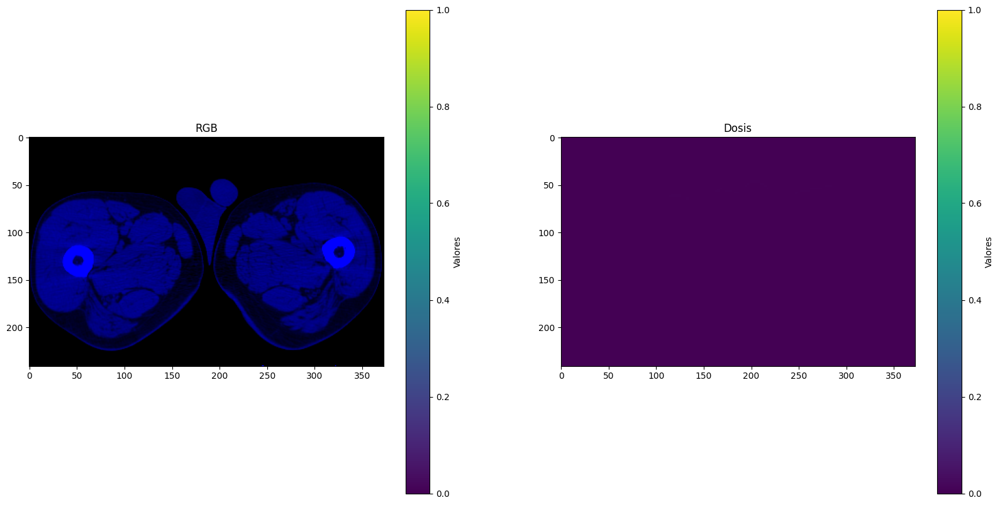

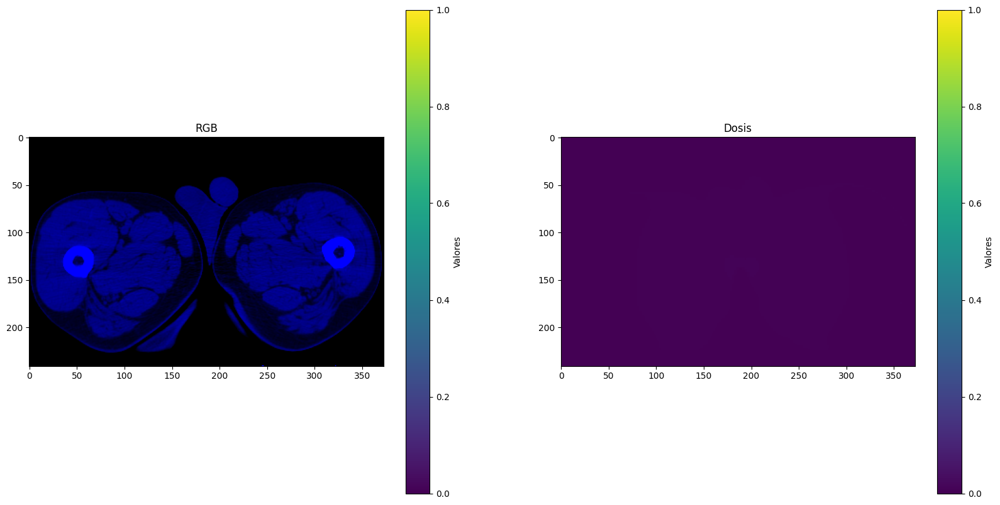

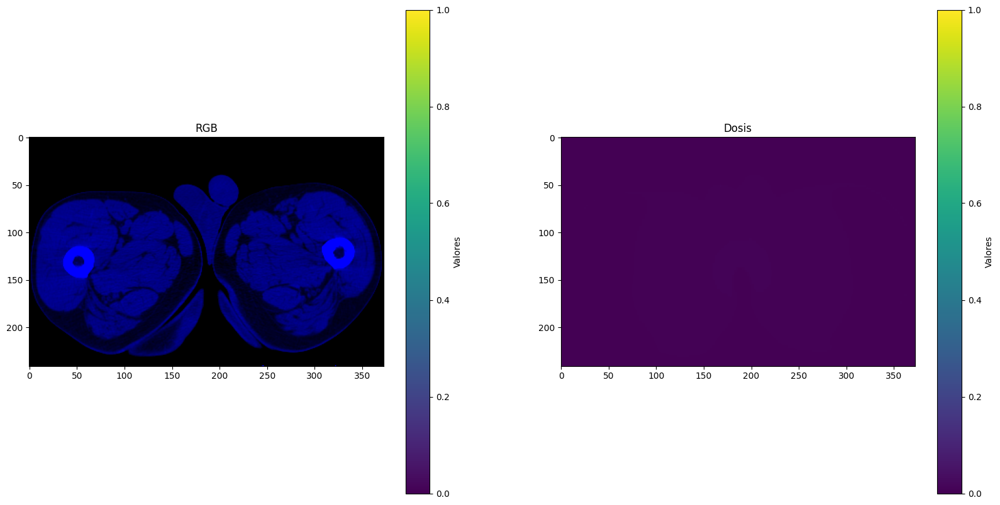

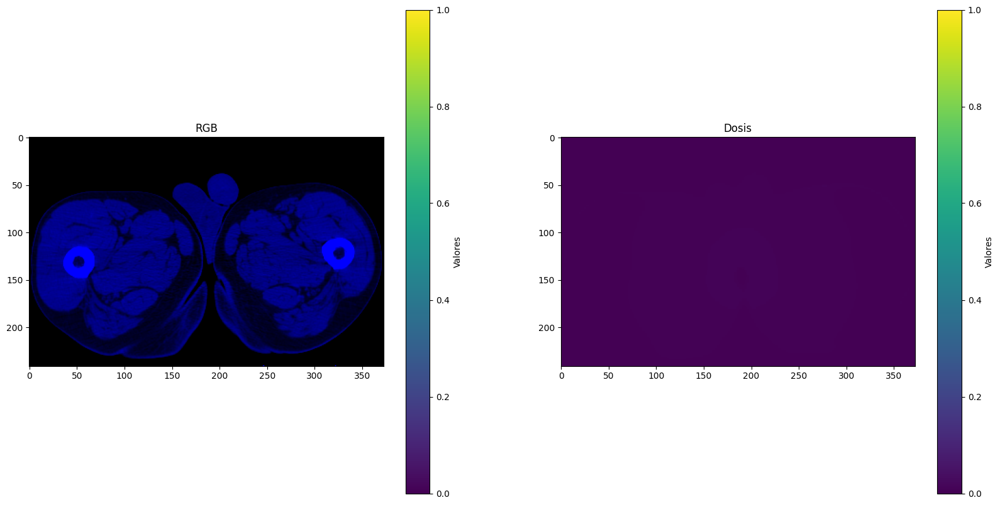

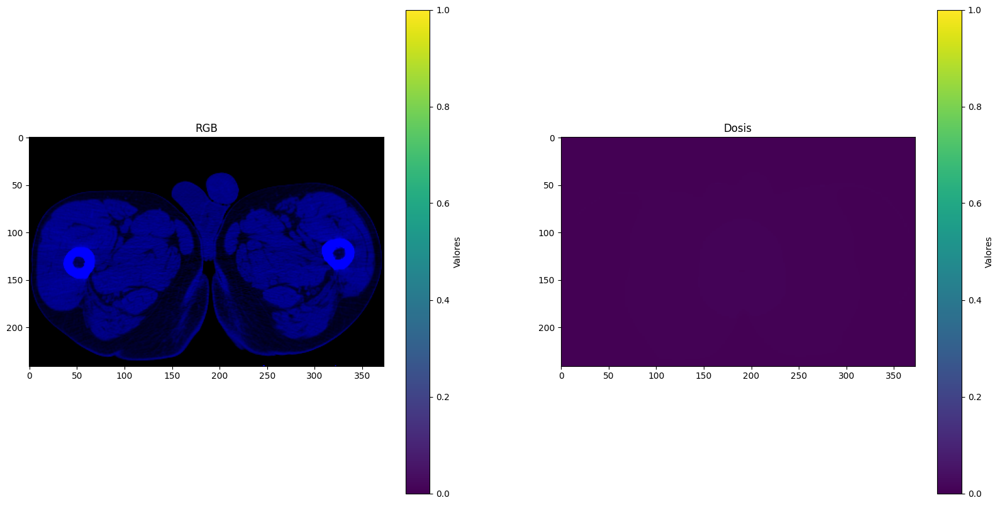

...

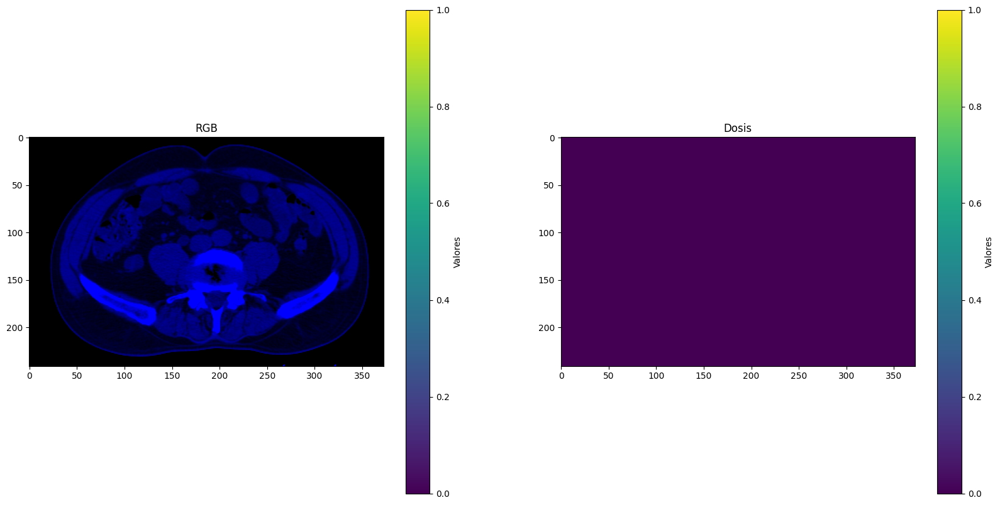

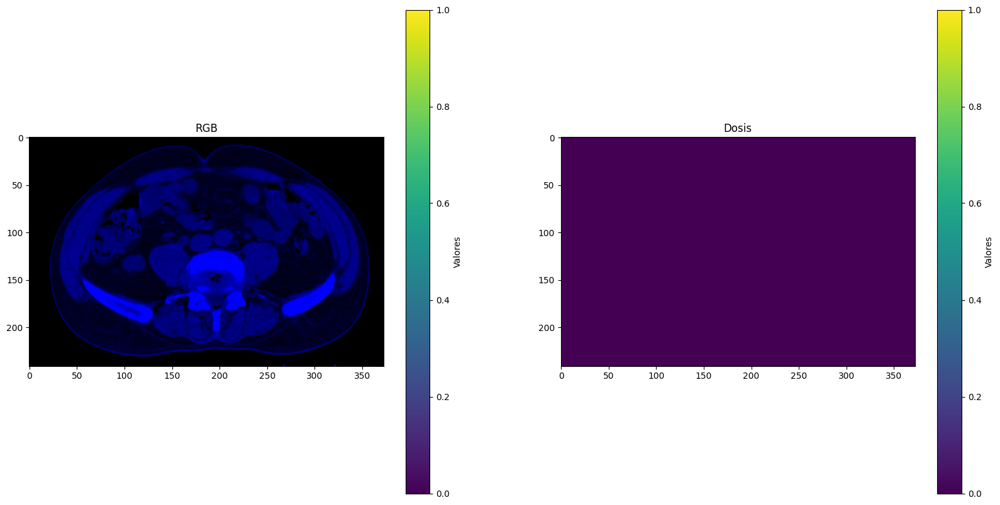

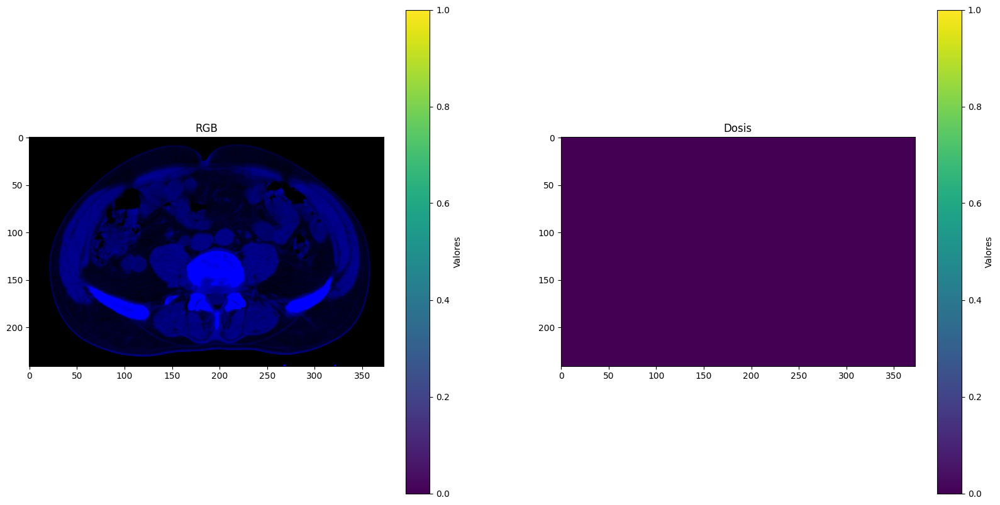

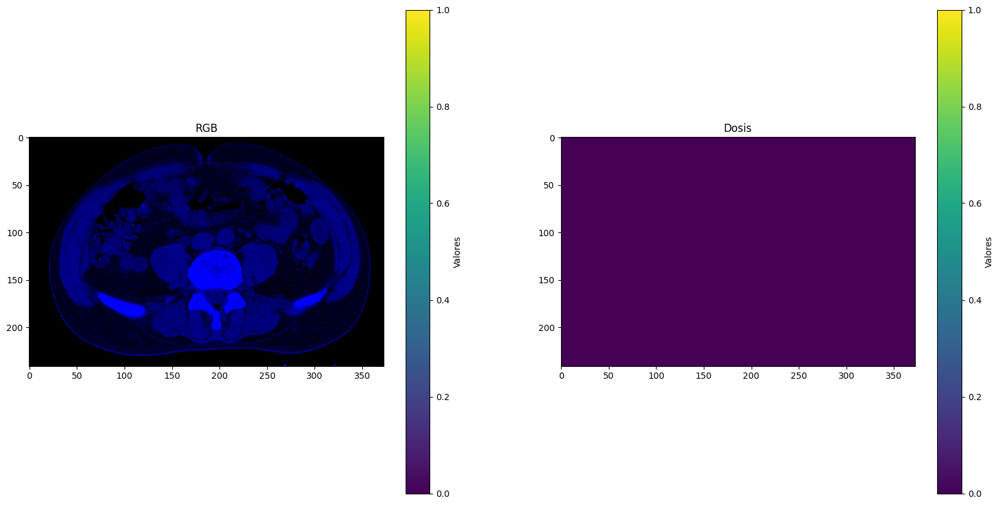

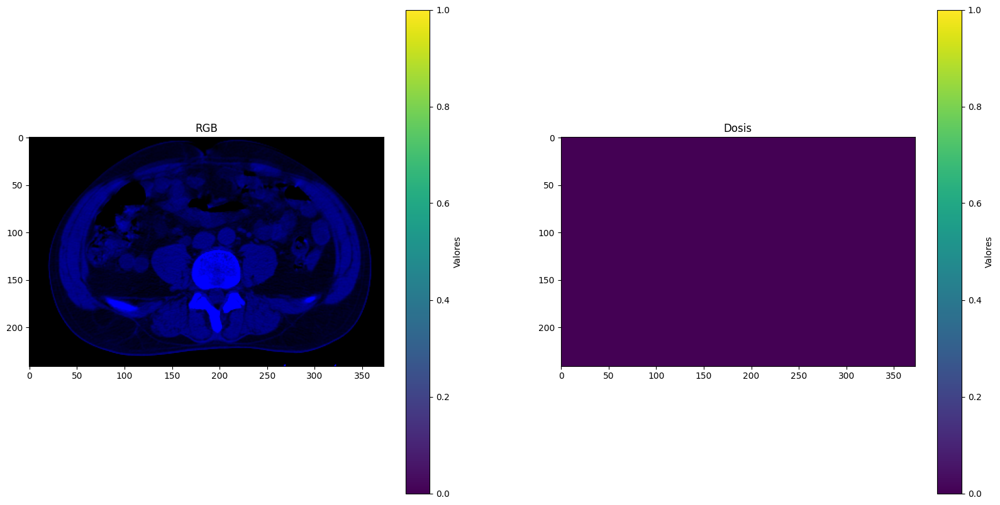

In [4]:
# Calcular los valores mínimos y máximos para ambas imágenes
min_value = min(tensor_rgb_normalizado.min(), tensor_dosis_normalizado.min())
max_value = max(tensor_rgb_normalizado.max(), tensor_dosis_normalizado.max())

for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
    # Crear las figuras y los ejes
    fig, axs = plt.subplots(1, 2, figsize=(20, 10))  # Ajusta el tamaño de la figura

    imagen1 =  tensor_rgb_normalizado[i].numpy()
    imagen2 =  tensor_dosis_normalizado[i].numpy()
    # Mostrar la primera imagen
    im1 = axs[0].imshow(imagen1, cmap='viridis', vmin=min_value, vmax=max_value)
    axs[0].set_title('RGB')

    # Añadir una barra de color vertical para la primera imagen
    cbar1 = fig.colorbar(im1, ax=axs[0])
    cbar1.set_label('Valores')
    
    # Mostrar la segunda imagen
    im2 = axs[1].imshow(imagen2, cmap='viridis', vmin=min_value, vmax=max_value)
    axs[1].set_title('Dosis')

    # Añadir una barra de color vertical para la segunda imagen
    cbar2 = fig.colorbar(im2, ax=axs[1])
    cbar2.set_label('Valores')

    # Mostrar las imágenes
    plt.show()
